<a href="https://colab.research.google.com/github/lukas-plojhar/Rhomberg-v2/blob/main/Rhomberg_v2_MMDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Morphology

In [ ]:
from PIL import Image, ImageMode
import numpy as np
import scipy, skimage
from scipy.ndimage import binary_dilation, binary_erosion, binary_fill_holes, binary_closing

# Input
sample = Image.open(os.path.join(ROOT, 'gt', f'{str(id)}.jpg')).convert('1')
sample_array = np.asarray(sample)

# Morphological operations
sample_array = binary_fill_holes(sample_array)
sample_array = binary_closing(sample_array)
sample_array = binary_fill_holes(sample_array)
sample_array = binary_closing(sample_array)
sample_array = binary_fill_holes(sample_array)

# Output
Image.fromarray(sample_array).convert('1')

# Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!unzip '/content/drive/MyDrive/vogis_600px_z17_annotated.zip'
!mv '/content/vogis_600px_z17' '/content/vogis'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!unzip '/content/drive/MyDrive/vogis_2717samples.zip'
!mv '/content/content/vogis_2717samples' '/content/vogis'
!rm -rf '/content/content'

# Dependencies

In [ ]:
!pip install pycocotools

# install dependencies: (use cu111 because colab has CUDA 11.1)
!pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html

# install mmcv-full thus we could use CUDA operators
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu111/torch1.9.0/index.html

# install mmdetection
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection

!pip install -e .

!mkdir checkpoints

In [ ]:
import os 
import mmcv
from mmcv.runner import load_checkpoint
from mmdet.models import build_detector
from mmdet.apis import train_detector, inference_detector, show_result_pyplot, set_random_seed, init_detector
from mmdet.datasets import build_dataset

# Model weights and configs


In [ ]:
models = dict()

# Mask R-CNN R50 FPN 3x PyTorch
!wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth \
      -O /content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth

models['mask_rcnn_r50'] = dict(config='/content/mmdetection/configs/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco.py', checkpoint='/content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth')

# # Mask R-CNN R50 FPN 3x PyTorch SCJ / SCP
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/simple_copy_paste/mask_rcnn_r50_fpn_syncbn-all_rpn-2conv_ssj_scp_32x2_270k_coco/mask_rcnn_r50_fpn_syncbn-all_rpn-2conv_ssj_scp_32x2_270k_coco_20220324_201229-80ee90b7.pth \
#       -O /content/mmdetection/checkpoints/mask_rcnn_r50_fpn_ssjscp.pth

# models['mask_rcnn_r50_SSJSCP'] = dict(config='/content/mmdetection/configs/simple_copy_paste/mask_rcnn_r50_fpn_syncbn-all_rpn-2conv_ssj_scp_32x2_270k_coco.py', checkpoint='/content/mmdetection/checkpoints/mask_rcnn_r50_fpn_ssjscp.pth')


# # Mask R-CNN R101 FPN 3x PyTorch
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r101_fpn_mstrain-poly_3x_coco/mask_rcnn_r101_fpn_mstrain-poly_3x_coco_20210524_200244-5675c317.pth \
#       -O /content/mmdetection/checkpoints/mask_rcnn_r101_fpn.pth

# models['mask_rcnn_r101'] = dict(config='/content/mmdetection/configs/mask_rcnn/mask_rcnn_r101_fpn_mstrain-poly_3x_coco.py', checkpoint='/content/mmdetection/checkpoints/mask_rcnn_r101_fpn.pth')

# # Mask R-CNN X101 32x8d FPN 3x PyTorch
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_x101_32x8d_fpn_mstrain-poly_3x_coco/mask_rcnn_x101_32x8d_fpn_mstrain-poly_3x_coco_20210607_161042-8bd2c639.pth \
#       -O /content/mmdetection/checkpoints/mask_rcnn_x101_fpn.pth

# models['mask_rcnn_x101'] = dict(config='/content/mmdetection/configs/mask_rcnn/mask_rcnn_x101_32x8d_fpn_mstrain-poly_3x_coco.py', checkpoint='/content/mmdetection/checkpoints/mask_rcnn_x101_fpn.pth')

# # Cascade Mask R-CNN R50 FPN 20e (41.9AP)
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/cascade_rcnn/cascade_mask_rcnn_r50_fpn_20e_coco/cascade_mask_rcnn_r50_fpn_20e_coco_bbox_mAP-0.419__segm_mAP-0.365_20200504_174711-4af8e66e.pth \
#       -O /content/mmdetection/checkpoints/cascade_mask_rcnn_r50.pth

# models['cascade_mask_rcnn_r50'] = dict(
#   config='/content/mmdetection/configs/cascade_rcnn/cascade_mask_rcnn_r50_fpn_20e_coco.py', 
#   checkpoint='/content/mmdetection/checkpoints/cascade_mask_rcnn_r50.pth'
# )

# # Sparse R-CNN R50 300 proposals multiscale randomcrop
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/sparse_rcnn/sparse_rcnn_r50_fpn_300_proposals_crop_mstrain_480-800_3x_coco/sparse_rcnn_r50_fpn_300_proposals_crop_mstrain_480-800_3x_coco_20201223_024605-9fe92701.pth \
#       -O /content/mmdetection/checkpoints/sparse_rcnn_r50.pth


# models['sparse_rcnn_r50'] = dict(
#   config='/content/mmdetection/configs/sparse_rcnn/sparse_rcnn_r50_fpn_300_proposals_crop_mstrain_480-800_3x_coco.py', 
#   checkpoint='/content/mmdetection/checkpoints/sparse_rcnn_r50.pth'
# )


# Mask R-CNN SWIN 3x multiscale crop fp16 (48.2AP)
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/swin/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth \
#       -O /content/mmdetection/checkpoints/mask_swin_s.pth

# models['mask_swin_s'] = dict(
#   config='/content/mmdetection/configs/swin/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco.py', 
#   checkpoint='/content/mmdetection/checkpoints/mask_swin_s.pth'
# )

# VFNET R-101 49.2 BOX AP
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/vfnet/vfnet_r101_fpn_mdconv_c3-c5_mstrain_2x_coco/vfnet_r101_fpn_mdconv_c3-c5_mstrain_2x_coco_20201027pth-7729adb5.pth \
#       -O /content/mmdetection/checkpoints/vfnet_r101.pth

# models['vfnet_r101'] = dict(config='/content/mmdetection/configs/vfnet/vfnet_r101_fpn_mdconv_c3-c5_mstrain_2x_coco.py', checkpoint='/content/mmdetection/checkpoints/vfnet_r101.pth')


# # Mask R-CNN R101 FPN 3x PyTorch
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth \
#       -O /content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth

# models['mask_rcnn_r50'] = dict(config='/content/mmdetection/configs/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco.py', checkpoint='/content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth')

# # Mask R-CNN R101 FPN 3x PyTorch
# !wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth \
#       -O /content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth

# models['mask_rcnn_r50'] = dict(config='/content/mmdetection/configs/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco.py', checkpoint='/content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth')

--2022-06-30 17:11:31--  https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.252.96.28
Connecting to download.openmmlab.com (download.openmmlab.com)|47.252.96.28|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177868694 (170M) [application/octet-stream]
Saving to: ‘/content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth’

/content/mmdetectio 100%[===================>] 169.63M  8.30MB/s    in 21s     

2022-06-30 17:11:53 (8.02 MB/s) - ‘/content/mmdetection/checkpoints/mask_rcnn_r50_fpn.pth’ saved [177868694/177868694]



# Other models and weights

In [ ]:
# Cascade Mask R-CNN R101 FPN 3x PyTorch (45.5AP 7.8 GB)
!wget -c https://download.openmmlab.com/mmdetection/v2.0/cascade_rcnn/cascade_mask_rcnn_r101_fpn_mstrain_3x_coco/cascade_mask_rcnn_r101_fpn_mstrain_3x_coco_20210628_165236-51a2d363.pth \
      -O /content/mmdetection/checkpoints/cascade_mask_rcnn_r101.pth

models['cascade_mask_rcnn_r101'] = dict(
  config='/content/mmdetection/configs/cascade_rcnn/cascade_mask_rcnn_r101_fpn_mstrain_3x_coco.py', 
  checkpoint='/content/mmdetection/checkpoints/cascade_mask_rcnn_r101.pth'
)

# Cascade Mask R-CNN X101 32x4d FPN 3x PyTorch (46.3AP 9.0 GB)
!wget -c https://download.openmmlab.com/mmdetection/v2.0/cascade_rcnn/cascade_mask_rcnn_x101_32x4d_fpn_mstrain_3x_coco/cascade_mask_rcnn_x101_32x4d_fpn_mstrain_3x_coco_20210706_225234-40773067.pth \
      -O /content/mmdetection/checkpoints/cascade_mask_rcnn_x101.pth

models['cascade_mask_rcnn_x101'] = dict(
    config='/content/mmdetection/configs/cascade_rcnn/cascade_mask_rcnn_x101_32x4d_fpn_mstrain_3x_coco.py', 
    checkpoint='/content/mmdetection/checkpoints/cascade_mask_rcnn_x101.pth'
)

# Cascade Mask R-CNN Swin-S 3x Multi-scale crop FP16 (48.2AP 11.9 GB)
!wget -c https://github.com/SwinTransformer/storage/releases/download/v1.0.2/cascade_mask_rcnn_swin_base_patch4_window7.pth \
      -O /content/mmdetection/checkpoints/cascade_mask_rcnn_swin_s.pth

models['cascade_mask_rcnn_swin_s'] = dict(
  config='/content/mmdetection/configs/swin/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco.py', 
  checkpoint='/content/mmdetection/checkpoints/cascade_mask_rcnn_swin_s.pth'
)

# Hybrid Task Cascade X-101-64x4d-FPN (50.4AP 14.5 GB)
!wget -c https://download.openmmlab.com/mmdetection/v2.0/htc/htc_r50_fpn_1x_coco/htc_r50_fpn_1x_coco_20200317-7332cf16.pth \
      -O /content/mmdetection/checkpoints/htc.pth

models['htc'] = dict(
  config='/content/mmdetection/configs/htc/htc_without_semantic_r50_fpn_1x_coco.py', 
  checkpoint='/content/mmdetection/checkpoints/htc.pth'
)


# DetectoRS HTC + ResNet101 20e (50.5AP 19.6 GB)
!wget -c https://download.openmmlab.com/mmdetection/v2.0/detectors/detectors_htc_r101_20e_coco/detectors_htc_r101_20e_coco_20210419_203638-348d533b.pth \
      -O /content/mmdetection/checkpoints/detectors_htc_resnet101.pth

models['detectors_htc_resnet101'] = dict(
  config='/content/mmdetection/configs/detectors/detectors_htc_r101_20e_coco.py', 
  checkpoint='/content/mmdetection/checkpoints/detectors_htc_resnet101.pth'
)

# Mask2Former + ResNet101 20e (xAP x GB)
!wget -c https://download.openmmlab.com/mmdetection/v2.0/detectors/detectors_htc_r101_20e_coco/detectors_htc_r101_20e_coco_20210419_203638-348d533b.pth \
      -O /content/mmdetection/checkpoints/detectors_htc_resnet101.pth

models['mask2former_resnet101'] = dict(
  config='/content/mmdetection/configs/mask2former/mask2former_r101_lsj_8x2_50e_coco.py', 
  checkpoint='/content/mmdetection/checkpoints/detectors_htc_resnet101.pth'
)

# YOLOX-s (input size 640) (50.9AP 28.1 GB)
!wget -c https://download.openmmlab.com/mmdetection/v2.0/yolox/yolox_x_8x8_300e_coco/yolox_x_8x8_300e_coco_20211126_140254-1ef88d67.pth \
      -O /content/mmdetection/checkpoints/yolox_x.pth

models['yolox_x'] = dict(
  config='/content/mmdetection/configs/yolox/yolox_x_8x8_300e_coco.py', 
  checkpoint='/content/mmdetection/checkpoints/yolox_x.pth'
)

# Training setup

In [ ]:
def get_params_count(model) -> None:
  """
  Returns total number of trainable parameters
  """
  total_params = sum(p.numel() for p in model.parameters())
  total_trainable_params = sum(
      p.numel() for p in model.parameters() if p.requires_grad)

  return print(f'Trainable = {total_trainable_params} | Total = {total_params} | Ratio = {round(total_trainable_params/total_params * 100)} %')

In [ ]:
# Default pipeline
cfg.data.train.dataset.pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='LoadAnnotations',
        with_bbox = True,
        with_mask = True,
        poly2mask = False, 
    ),
    dict(
        type='Resize',
        keep_ratio = True,
        multiscale_mode = 'range',
        img_scale = [(1333, 640), (1333, 800)], 
    ),
    dict(
        type='RandomFlip',
        flip_ratio = 0.5,
    ),
    dict(
        type='Normalize',
        to_rgb = True,
        mean = [123.675, 116.28, 103.53],
        std = [58.395, 57.12, 57.375], 
    ),
    dict(
        type='Pad',
        size_divisor = 32,
    ),
    dict(type='DefaultFormatBundle'),
    dict(
        type='Collect',
        keys = ['img', 'gt_bboxes', 'gt_labels', 'gt_masks']
    )
]

# Edited pipeline
cfg.data.train.dataset.pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='LoadAnnotations',
        with_bbox = True,
        with_mask = True,
        poly2mask = False, 
    ),
    dict(
        type='Resize',
        keep_ratio = True,
        multiscale_mode = 'range',
        # ratio_range = [(0.8, 1.25)],
        img_scale = [(750, 480)], 
        #  img_scale = [(1333, 640), (1333, 800)], 
    ),
    dict(
        type='RandomFlip',
        flip_ratio = 0.5,
    ),
    dict(
        type='Normalize',
        to_rgb = True,
        mean = [123.675, 116.28, 103.53],
        std = [58.395, 57.12, 57.375], 
    ),
    dict(
        type='Pad',
        size_divisor = 32,
    ),
    dict(type='DefaultFormatBundle'),
    dict(
        type='Collect',
        keys = ['img', 'gt_bboxes', 'gt_labels', 'gt_masks'],
    ),
]

# cfg.data.val.pipeline = cfg.data.train.dataset.pipeline
# cfg.data.test.pipeline = cfg.data.train.dataset.pipeline

In [ ]:
MODEL_NAME          = 'mask_rcnn_r50'
CLASSES             = ('building', )
device              = 'cuda'
log_folder          = '/content/resnet_exps'
workflow            = [('train', 4), ('val', 1)]
config_file         = models[MODEL_NAME]['config']
checkpoint_file     = models[MODEL_NAME]['checkpoint']

# BUILD MODEL
cfg = mmcv.Config.fromfile(config_file)
cfg.load_from = checkpoint_file
cfg.workflow = workflow
cfg.work_dir = log_folder
cfg.gpu_ids = range(1)
cfg.device = 'cuda'
cfg.seed = 0 # starej seed: 46
# cfg.image_size = (600, 600)


# CHANGING HEAD
if MODEL_NAME in ['sparse_rcnn_r50']:
  for head in cfg.model.roi_head.bbox_head:
    head.num_classes = 1


if MODEL_NAME in ['mask_rcnn_r50', 'mask_rcnn_r101', 'mask_rcnn_x101', 'mask_rcnn_r50_SSJSCP']:
  cfg.model.roi_head.bbox_head.num_classes = len(CLASSES)
  cfg.model.roi_head.mask_head.num_classes = len(CLASSES)

if MODEL_NAME == 'vfnet_r101':
  cfg.model.bbox_head.num_classes = len(CLASSES)

if MODEL_NAME in ['cascade_mask_rcnn_r50', 'cascade_mask_rcnn_r101', 'cascade_mask_rcnn_x101', 'htc']:
  cfg.model.roi_head.bbox_head[0].num_classes = 1
  cfg.model.roi_head.bbox_head[1].num_classes = 1
  cfg.model.roi_head.bbox_head[2].num_classes = 1

  if MODEL_NAME == 'htc':
    cfg.model.roi_head.mask_head[0].num_classes = 1
    cfg.model.roi_head.mask_head[1].num_classes = 1
    cfg.model.roi_head.mask_head[2].num_classes = 1

  else:
    cfg.model.roi_head.mask_head.num_classes = 1

if MODEL_NAME == 'cascade_mask_rcnn_swin_s':
  cfg.model.roi_head.bbox_head.num_classes = 1
  cfg.model.roi_head.mask_head.num_classes = 1

# DATA
folder_name = 'vogis'
cfg.data.samples_per_gpu = 6
cfg.data.workers_per_gpu = 2

# Cascade-specific
if MODEL_NAME in ['mask_swin_s', 'cascade_mask_rcnn_swin_s', 'cascade_mask_rcnn_r50', 'htc', 'vfnet_r101', 'sparse_rcnn_r50']:
  cfg.data.train.ann_file = f'/content/{folder_name}/train/annotations.json'
  cfg.data.train.img_prefix = f'/content/{folder_name}/train/images/'
  cfg.data.train.classes = CLASSES

  # Swin-specific
  if MODEL_NAME in ['cascade_mask_rcnn_swin_s', 'mask_swin_s']:
    meta = dict()
    meta['fp16'] = dict(loss_scale=512.)

else:
  cfg.data.train.dataset.ann_file = f'/content/{folder_name}/train/annotations.json'
  cfg.data.train.dataset.img_prefix = f'/content/{folder_name}/train/images/'
  cfg.data.train.dataset.classes = CLASSES

cfg.data.val.ann_file = f'/content/{folder_name}/validation/annotations.json'
cfg.data.val.img_prefix = f'/content/{folder_name}/validation/images/'
cfg.data.val.classes = CLASSES

cfg.data.test.ann_file = f'/content/{folder_name}/test/annotations.json'
cfg.data.test.img_prefix = f'/content/{folder_name}/test/images/'
cfg.data.test.classes = CLASSES

# OPTIMIZER AND LR SCHEDULE
# Linear rule
cfg.optimizer.lr = cfg.optimizer.lr * cfg.data.samples_per_gpu / 256

cfg.lr_config = dict(
    policy='step',
    step=[1500, 1800])


# cfg.optimizer_config = dict(grad_clip=dict(max_norm=5))
# cfg.optimizer.lr = 0.002

# cfg.lr_config = dict(
#     policy='cyclic',
#     target_ratio=(10, 1),
#     cyclic_times=100,
#     step_ratio_up=0.4,
# )

# cfg.lr_config = dict(
#     policy = 'CosineRestart',
#     periods = [600, 300, 300, 100, 100, 100, 20],
#     restart_weights = [1, 1, 1, 1, 1, 1, 1]
#     min_lr = 0.02 / 10 / 10
# )

# Swin uses 36e with step at [27, 33]
# cfg.lr_config = dict(
#     policy = 'step',
#     step = [10000, 13250],
# )

# Swin, try using same ratios
cfg.lr_config = dict(
    policy = 'OneCycle',
    max_lr = cfg.optimizer.lr * cfg.data.samples_per_gpu / 256 * 100
)

# momentum_config = dict(
#     policy='cyclic',
#     target_ratio=(0.85 / 0.95, 1),
#     cyclic_times=1,
#     step_ratio_up=0.4,
# )


# EVALUATION AND LOGGING
cfg.log_config.interval = 1
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook'),
]

cfg.evaluation.metric = ['bbox']

# cfg.evaluation.interval = 20
# cfg.evaluation.iou_thrs = [0.5]
cfg.checkpoint_config.interval = 2000


# RUNNER
cfg.runner = dict(
    type          = 'IterBasedRunner',
    max_iters      = 2000 # 996 * 12
) 

# SEED
cfg.seed = 46
    
# cfg.data.train.dataset.pipeline[2].multiscale_mode = False
# cfg.data.train.dataset.pipeline[3].flip_ratio = 0.000000000001


if MODEL_NAME in ['mask_swin_s', 'cascade_mask_rcnn_swin_s', 'cascade_mask_rcnn_r50', 'htc', 'vfnet_r101', 'sparse_rcnn_r50']:
  cfg.data.val.pipeline = cfg.data.train.pipeline
else:
  cfg.data.val.pipeline = cfg.data.train.dataset.pipeline

In [ ]:
cfg.runner.max_epochs = 12

In [ ]:
cfg.lr_config.step = [9, 11]

{'policy': 'step',
 'step': [27, 33],
 'warmup': 'linear',
 'warmup_iters': 1000,
 'warmup_ratio': 0.001}

 max_epochs = 36

In [ ]:
print(cfg.pretty_text)

In [ ]:
# Change all input channels to [600, 600]
cfg.data.train.dataset.pipeline[2]['img_scale'] = (600, 600)
cfg.data.val.pipeline[2]['img_scale'] = (600, 600)
cfg.data.test.pipeline[1]['img_scale'] = (600, 600)

# Remove flipping
cfg.data.train.dataset.pipeline[3]['flip_ratio'] = 0.00001
cfg.data.val.pipeline[3]['flip_ratio'] = 0.000001
del(cfg.data.test.pipeline[1]['transforms'][1]) # remove random flip TTA

# cfg.data.val.ann_file = cfg.data.train.dataset.ann_file
# cfg.data.val.img_prefix = cfg.data.train.dataset.img_prefix
# cfg.data.val.classes = CLASSES

# cfg.data.test.ann_file = cfg.data.train.dataset.ann_file
# cfg.data.test.img_prefix = cfg.data.train.dataset.img_prefix
# cfg.data.test.classes = CLASSES

In [ ]:
original_trans = cfg.data.test.pipeline[1].transforms

dict(type='RandomFlip'),

In [ ]:
cfg.data.test.pipeline[1].transforms 

[{'keep_ratio': True, 'type': 'Resize'},
 {'p': 0.5, 'type': 'RandomFlip'},
 {'mean': [123.675, 116.28, 103.53],
  'std': [58.395, 57.12, 57.375],
  'to_rgb': True,
  'type': 'Normalize'},
 {'size_divisor': 32, 'type': 'Pad'},
 {'keys': ['img'], 'type': 'ImageToTensor'},
 {'keys': ['img'], 'type': 'Collect'}]

In [ ]:
cfg.data.test.pipeline[1].transforms.insert(1, dict(type='RandomFlip', p=0.5))

In [ ]:
del(cfg.data.test.pipeline[1].transforms[1]['p'])

In [ ]:
cfg.data.test.pipeline[1].transforms = [
    dict(type='Resize', keep_ratio = True),
    dict(type='ShiftScaleRotate', shift_limit = 0.1, rotate_limit = 45, p=0.75),
    dict(type='Normalize', mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True),
    dict(type='Pad', size_divisor=32),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_bboxes', 'gt_labels', 'gt_masks'])
]

In [ ]:
cfg.data.test.pipeline[1].img_scale = (870, 330)

In [ ]:
# cfg.optimizer = dict(
#     type = 'Adam',
#     lr = 1e-6,
#     weight_decay = 0.0001
# )

# 1e-3 or 3e-4
# Optimizer Adam
# Learning rate 1.e-6
# Weight decay 1.e-4

In [ ]:
# BACKBONE
# cfg.model.backbone.frozen_stages = 1

# BUILD AND TRAIN MODEL
model         = build_detector(cfg.model)
datasets      = [build_dataset(cfg.data.train), build_dataset(cfg.data.val)]
model.CLASSES = CLASSES
mmcv.mkdir_or_exist(os.path.abspath(cfg.work_dir))

# FREEZE NECK
# for param in model.backbone.parameters():
#   param.requires_grad = True

# for param in model.neck.parameters():
#   param.requires_grad = True

# DEBUGGING
print('MODEL')
get_params_count(model)
print('MODEL - backbone')
get_params_count(model.backbone)
print('MODEL - neck')
get_params_count(model.neck)

# # Swin-specific
if MODEL_NAME in ['cascade_mask_rcnn_swin_s', 'mask_swin_s']:
  train_detector(model, datasets, cfg, distributed=False, validate=False, meta=meta)

else:
  train_detector(model, datasets, cfg, distributed=False, validate=False)
  pass

# NAS-FPN

In [ ]:
cfg.model.neck.type = 'NASFPN'
cfg.model.neck.stack_times = 3
# cfg.model.neck.add_extra_convs = True
# cfg.model.neck.norm_cfg=cfg.model.backbone.norm_cfg
# del(cfg.model.neck.stack_level)

cfg.data.train.dataset.pipeline[-3]['size_divisor'] = 128
cfg.data.train.dataset.pipeline

cfg.model.neck

NameError: ignored

# Second stage

Vezmu checkkpoint, nastavim resume_from a a pust9m na Resnet Stage 4 and up pro 120 epoch

In [ ]:
cfg.resume_from = '/content/resnet_exps/iter_500.pth'
# cfg.runner.max_iters = 1125

# datasets      = [build_dataset(cfg.data.train.dataset)]
# cfg.evaluation.interval = 1

# BACKBONE
cfg.model.backbone.frozen_stages = 3

# BUILD MODEL
model = build_detector(cfg.model)

# NECK
for param in model.neck.parameters():
  param.requires_grad = True

# DEBUGGING
print('MODEL')
get_params_count(model)
print('MODEL - backbone')
get_params_count(model.backbone)
print('MODEL - neck')
get_params_count(model.neck)

# print(cfg.pretty_text)
train_detector(model, datasets, cfg, validate=False)

2022-06-27 17:45:30,874 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2022-06-27 17:45:30,878 - mmdet - INFO - load checkpoint from local path: /content/resnet_exps/iter_500.pth


MODEL
Trainable = 35427862 | Total = 43971158 | Ratio = 81 %
MODEL - backbone
Trainable = 14964736 | Total = 23508032 | Ratio = 64 %
MODEL - neck
Trainable = 3344384 | Total = 3344384 | Ratio = 100 %


2022-06-27 17:45:31,083 - mmdet - INFO - resumed from epoch: 1, iter 499
2022-06-27 17:45:31,086 - mmdet - INFO - Start running, host: root@965c5e06ed8b, work_dir: /content/resnet_exps
2022-06-27 17:45:31,089 - mmdet - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) OneCycleLrUpdaterHook              
(NORMAL      ) CheckpointHook                     
(VERY_LOW    ) TextLoggerHook                     
(VERY_LOW    ) TensorboardLoggerHook              
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) OneCycleLrUpdaterHook              
(NORMAL      ) NumClassCheckHook                  
(LOW         ) IterTimerHook                      
(VERY_LOW    ) TextLoggerHook                     
(VERY_LOW    ) TensorboardLoggerHook              
 -------------------- 
before_train_iter:
(VERY_HIGH   ) OneCycleLrUpdaterHook              
(LOW         ) IterTimerHook                      
 -------------------- 
after_train_iter:
(ABOVE_NORMAL) OptimizerHook

KeyboardInterrupt: ignored

# Last stage

In [ ]:
checkpoint_file = '/content/resnet_exps/iter_1500.pth'
cfg.resume_from = checkpoint_file
# cfg.runner.max_iters = 1500

# BACKBONE
cfg.model.backbone.frozen_stages = 0

# BUILD MODEL
model = build_detector(cfg.model)

# NECK
for param in model.neck.parameters():
  param.requires_grad = True

# DEBUGGING
print('MODEL')
get_params_count(model)
print('MODEL - backbone')
get_params_count(model.backbone)
print('MODEL - neck')
get_params_count(model.neck)

# print(cfg.pretty_text)
train_detector(model, datasets, cfg, distributed=False, validate=False)

MODEL
Trainable = 43961622 | Total = 43971158 | Ratio = 100 %
MODEL - backbone
Trainable = 23498496 | Total = 23508032 | Ratio = 100 %
MODEL - neck
Trainable = 3344384 | Total = 3344384 | Ratio = 100 %


2022-06-27 18:04:46,128 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2022-06-27 18:04:46,135 - mmdet - INFO - load checkpoint from local path: /content/resnet_exps/iter_1500.pth
2022-06-27 18:04:46,391 - mmdet - INFO - resumed from epoch: 1, iter 1499
2022-06-27 18:04:46,394 - mmdet - INFO - Start running, host: root@965c5e06ed8b, work_dir: /content/resnet_exps
2022-06-27 18:04:46,395 - mmdet - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) OneCycleLrUpdaterHook              
(NORMAL      ) CheckpointHook                     
(VERY_LOW    ) TextLoggerHook                     
(VERY_LOW    ) TensorboardLoggerHook              
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) OneCycleLrUpdaterHook              
(NORMAL      ) NumClassCheckHook                  
(LOW         ) IterTimerHook                      
(VERY_LOW    ) TextLoggerHook                     
(VERY_LOW    ) TensorboardLoggerHook              
 --

# Evaluation in TensorBoard

In [ ]:
!rm -rf /content/resnet_exps/

In [ ]:
# load tensorboard in colab
%reload_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir /content/resnet_exps

Reusing TensorBoard on port 6006 (pid 920), started 2:11:18 ago. (Use '!kill 920' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# load tensorboard in colab
%reload_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir /content/content/resnet_exps

<IPython.core.display.Javascript object>

In [ ]:
!cp /content/drive/MyDrive/2706_tests.zip /content/2706_tests.zip 

In [ ]:
!ls /content/resnet_exps/

ls: cannot access '/content/resnet_exps/': No such file or directory


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/2706_tests.zip -d /content

In [ ]:
!cp /content/SC_experiments.zip /content/drive/MyDrive/SC_experiments.zip

In [ ]:
!zip -r /content/2806_test.zip /content

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Own

load checkpoint from local path: /content/content/resnet_exps/SC_2k_linearbase_x100/iter_2000.pth


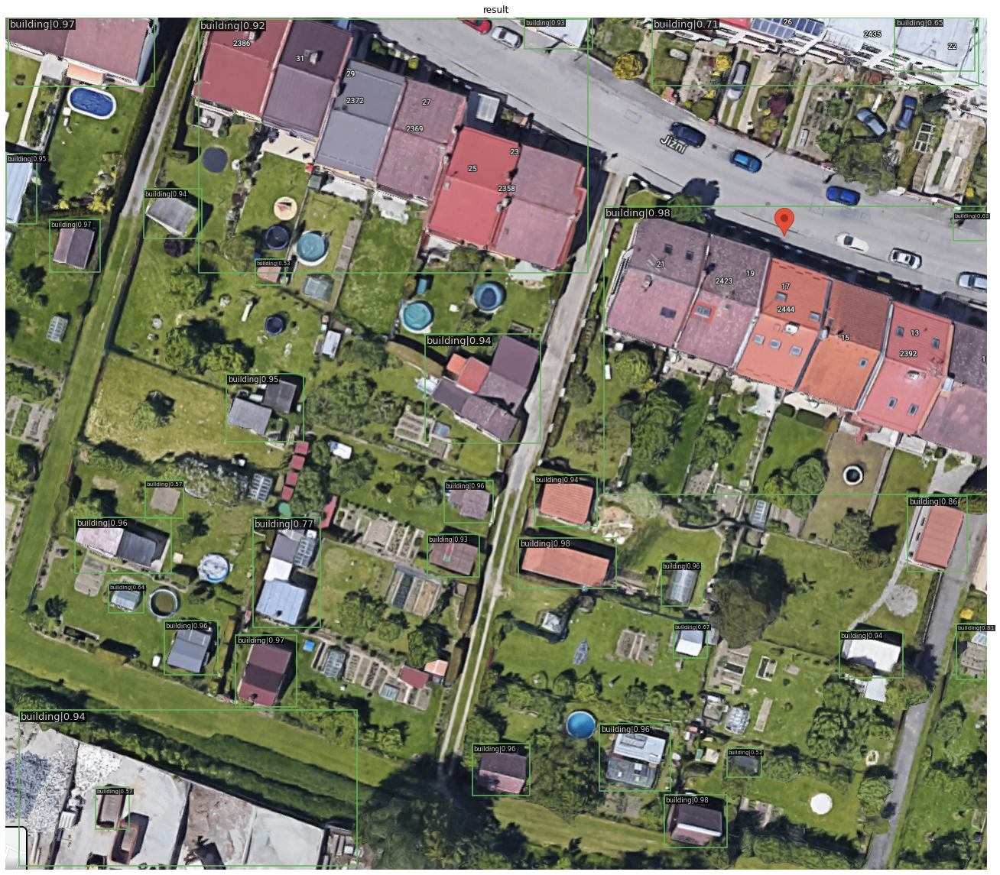

In [ ]:
folder_name = 'vogis'

imgs = [
        f'/content/{folder_name}/test/images/1069.jpg',
        f'/content/{folder_name}/test/images/1083.jpg',
        f'/content/{folder_name}/test/images/125.jpg',
        f'/content/{folder_name}/test/images/1265.jpg',
        f'/content/{folder_name}/test/images/1368.jpg',
        f'/content/{folder_name}/test/images/1565.jpg',
        f'/content/{folder_name}/test/images/1462.jpg',
        f'/content/{folder_name}/test/images/17.jpg',
]

imgs = [
         f'/content/cz1.png',
        f'/content/2018.png',
        f'/content/2017.png',
        f'/content/2012.png',
        f'/content/2006.png',
        f'/content/2001.png',
        f'/content/1990.png',
        f'/content/1980.png',
        f'/content/1970.png',
        f'/content/1950.png',
        f'/content/1930.png',
]


# 0, 1, 5
idx       = 10
threshold = 0.5

cfg.load_from = '/content/content/resnet_exps/SC_2k_linearbase_x100/iter_2000.pth'

# EDIT
model = init_detector(cfg, cfg.load_from)

# EDIT
model.cfg = cfg
model.CLASSES = CLASSES
result = inference_detector(model, imgs[idx])
show_result_pyplot(model, imgs[idx], result, score_thr=threshold)

In [ ]:
cfg.data.test.pipeline[1]['img_scale'] = (750,480)

In [ ]:
!cp /content/base_overfit.zip /content/drive/MyDrive

In [ ]:
# !rm '/content/new_config.py'

# cfg.load_from = '/content/resnet_exps/iter_1500.pth'
# cfg.load_from = '/content/resnet_exps/mask_r50_SC/iter_1500.pth'
cfg.load_from = '/content/resnet_exps/SC_final_30seed/iter_2000.pth'


# cfg.data.test.ann_file = f'/content/vogis/validation/annotations.json'
# cfg.data.test.img_prefix = f'/content/vogis/validation/images/'
# cfg.data.test.classes = CLASSES
cfg.evaluation.iou_thrs = [0.50]

with open('/content/new_config.py', 'w') as f:
  f.write(cfg.pretty_text)

In [ ]:
# !python mmdetection/tools/test.py /content/new_config.py /content/resnet_exps/iter_1500.pth --format-only --options "jsonfile_prefix=/content/cmask_r50"
# !python /content/mmdetection/tools/test.py /content/new_config.py /content/resnet_exps/iter_1500.pth --eval bbox 

# !python mmdetection/tools/test.py /content/new_config.py /content/resnet_exps/mask_r50_SC/iter_1500.pth --format-only --options "jsonfile_prefix=/content/mask_r50"
!python /content/mmdetection/tools/test.py /content/new_config.py /content/resnet_exps/SC_final_0seed/iter_2000.pth --eval bbox

/content/mmdetection/mmdet/utils/setup_env.py:39: UserWarning: Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  f'Setting OMP_NUM_THREADS environment variable for each process '
/content/mmdetection/mmdet/utils/setup_env.py:49: UserWarning: Setting MKL_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  f'Setting MKL_NUM_THREADS environment variable for each process '
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
load checkpoint from local path: /content/resnet_exps/SC_final_0seed/iter_2000.pth
[                                                  ] 0/156, elapsed: 0s, ETA:/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarnin

In [ ]:
print(cfg.pretty_text)

In [ ]:
!zip -r /content/2806_test.zip /content/resnet_exps

  adding: content/resnet_exps/ (stored 0%)
  adding: content/resnet_exps/cascade_step_12e/ (stored 0%)
  adding: content/resnet_exps/cascade_step_12e/epoch_12.pth (deflated 7%)
  adding: content/resnet_exps/cascade_step_12e/events.out.tfevents.1656410584.8725b845d4ff.1162.0 (deflated 72%)
  adding: content/resnet_exps/cascade_step_12e/None.log.json (deflated 84%)
  adding: content/resnet_exps/.ipynb_checkpoints/ (stored 0%)
  adding: content/resnet_exps/iter_2000.pth (deflated 7%)
  adding: content/resnet_exps/SC_2k_linearbase_x100/ (stored 0%)
  adding: content/resnet_exps/SC_2k_linearbase_x100/events.out.tfevents.1656424569.8725b845d4ff.2027.1 (deflated 5%)
  adding: content/resnet_exps/SC_2k_linearbase_x100/events.out.tfevents.1656424593.8725b845d4ff.2027.2 (deflated 71%)
  adding: content/resnet_exps/SC_2k_linearbase_x100/events.out.tfevents.1656421567.8725b845d4ff.2027.0 (deflated 71%)
  adding: content/resnet_exps/None.log.json (deflated 85%)
  adding: content/resnet_exps/step_2k

In [ ]:
!cp /content/2806_test.zip /content/drive/MyDrive/2806_test.zip 

In [ ]:
!cp /content/drive/MyDrive/2806_tests.zip /content/2806_tests.zip 

cp: cannot stat '/content/drive/MyDrive/2806_tests.zip': No such file or directory


In [ ]:
!unzip /content/2706_tests.zip

In [ ]:
!cp /content/base_tests.zip /content/drive/MyDrive